In [1]:
# Names of files containing the data
file = "cmems_mod_glo_phy_anfc_merged-uv_PT1H-i_multi-vars_74.17W-72.42W_37.50S-35.25S_0.49m_2023-01-01-2023-01-31.nc"
filenames = {
    'U': file,
    'V': file
}

# Names of the velocity component data in the file
variables = {
    'U': 'uo',
    'V': 'vo'
}

# Names of the dimensions in the file
dimensions = {
    'lat': 'latitude',
    'lon': 'longitude',
    'time': 'time'
}

In [2]:
from parcels import FieldSet

fieldset = FieldSet.from_netcdf(filenames, variables, dimensions)

In [3]:
from parcels import JITParticle, ParticleSet, Variable

# Define a new particleclass with Variable 'age' with initial value 0.
AgeParticle = JITParticle.add_variable(Variable("age", initial=0))

pset = ParticleSet(
    fieldset=fieldset,  # the fields that the particleset uses
    pclass=AgeParticle,  # define the type of particle
    lon=-73.1217,  # release longitude
    lat=-36.4137,  # release latitude
)

In [5]:
# load basic advection kernels
from parcels import AdvectionRK4

# Create a custom kernel which displaces each particle southward


def NorthVel(particle, fieldset, time):
    if time > 10 * 86400 and time < 10.2 * 86400:
        vvel = -1e-4
        particle_dlat += vvel * particle.dt


# Create a custom kernel which keeps track of the particle age (minutes)


def Age(particle, fieldset, time):
    particle.age += particle.dt / 3600


# define all kernels to be executed on particles using an (ordered) list
kernels = [Age, NorthVel, AdvectionRK4]

In [6]:
output_file = pset.ParticleFile(
    name="GCParticles.zarr",  # the name of the output file
    outputdt=3600,  # the time period between consecutive out output steps
    chunks=(1, 10),  # the chunking of the output file (number of particles, timesteps)
)

pset.execute(
    kernels,  # the kernel (which defines how particles move)
    runtime=86400 * 24,  # the total length of the run in seconds
    dt=3600,  # the timestep of the kernel in seconds
    output_file=output_file,
)

INFO: Output files are stored in GCParticles.zarr.
100%|█████████████████████████| 2073600.0/2073600.0 [00:17<00:00, 119890.41it/s]


/home/cl4/anaconda3/envs/parcels/lib/python3.12/site-packages/trajan/plot/__init__.py:159: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  num = self.ds.dims['trajectory']
/home/cl4/anaconda3/envs/parcels/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)


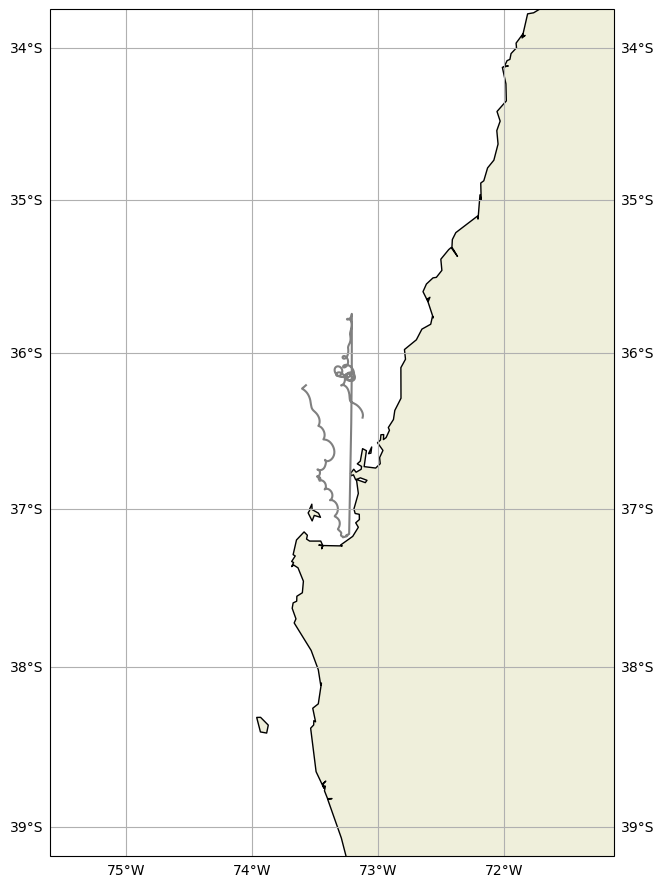

In [7]:
import xarray as xr
import trajan as ta
import matplotlib.pyplot as plt

ds = xr.open_zarr("GCParticles.zarr")
ds.traj.plot(margin=2)
plt.show()

In [6]:
from datetime import timedelta
import numpy as np
import xarray as xr
import trajan as ta
import matplotlib.pyplot as plt

# Load the trajectory data
trajectory_filename = "GCParticles.zarr"
data_xarray = xr.open_zarr(trajectory_filename)

dt = np.timedelta64(timedelta(minutes=30))

# Times at which to plot
timerange = np.arange(
    np.nanmin(data_xarray['time'].values),
    np.nanmax(data_xarray['time'].values) + dt,
    dt
)

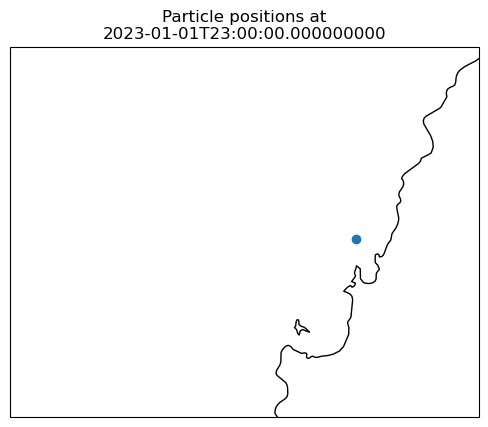

In [7]:
import cartopy
import cartopy.crs as ccrs
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

#Initialise the figure
fig = plt.figure()
ax = fig.add_subplot(projection=ccrs.PlateCarree())

# Initial time ID
time_id = np.where(data_xarray['time'] == timerange[0])

# Initial plot positions
scatter = ax.scatter(data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id])

# Graph settings
t = str(timerange[0])
title = ax.set_title("Particle positions at \n"+t)
ax.set_xlabel('Longitude [°E]')
ax.set_ylabel('Latitude [°N]')
ax.set_xlim(-75.5356,-72.2668)
ax.set_ylim(-37.6519,-35.0738)
#ax.set_xticks(np.linspace(113, 114.5, 4))
#ax.set_yticks(np.linspace(22, 23, 3))
ax.coastlines()
ax.grid()

def animate(i):

    # Update title
    t = str(timerange[i])
    title.set_text("Particle positions at\n"+t)

    # Update scatter positions
    time_id = np.where(data_xarray['time'] == timerange[i])
    scatter.set_offsets(np.c_[data_xarray['lon'].values[time_id], data_xarray['lat'].values[time_id]])

anim = FuncAnimation(fig, animate, frames=len(timerange), interval=500)

In [8]:
from IPython.display import HTML
HTML(anim.to_jshtml())

Animation size has reached 20991210 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
